## Imports 

In [1]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import math

## Importing the dataset : 

In [2]:
Open_FF_dataset = pd.read_csv("C:/Users/pdevi/OneDrive/Desktop/OpenClassrooms/Projet_1/fr.openfoodfacts.org.products.csv",sep='\t' , low_memory=False,on_bad_lines='skip')                           

# Étape 1 : Nettoyez et filtrez des features et produits

### Enlever les duplicatas dans la base de données : 

In [3]:
# Nombre total de lignes avant suppression
total_lignes_avant = len(Open_FF_dataset)

# Compter le nombre de lignes dupliquées basées sur 'code'
duplicatas = Open_FF_dataset.duplicated(subset=['code']).sum()

# Afficher le nombre de lignes dupliquées
print(f"Nombre de lignes dupliquées basées sur 'code': {duplicatas}")

# Supprimer les doublons
Open_FF_dataset.drop_duplicates(subset=['code'], inplace=True)

# Vérifier le nombre de lignes après suppression pour confirmation
total_lignes_apres = len(Open_FF_dataset)
lignes_removed = total_lignes_avant - total_lignes_apres

print(f"Nombre de lignes supprimées: {lignes_removed}")
print(f"Nombre de lignes total initial: {total_lignes_avant}")


Nombre de lignes dupliquées basées sur 'code': 22
Nombre de lignes supprimées: 22
Nombre de lignes total initial: 320772


## Séparer les features quantitatives et qualitatives

In [4]:
quantitative_features = []
qualitative_features = []

for column in Open_FF_dataset.columns:
    if Open_FF_dataset[column].dtype in ['int64', 'float64']:
        quantitative_features.append(column)
    else:
        qualitative_features.append(column)

# Afficher les fonctionnalités quantitatives et qualitatives
print('Nombre de variables quantitatives : ',len(quantitative_features))
print('\nNombre de variables qualitatives : ',len(qualitative_features))
print("\nVariables quantitatives :", quantitative_features)
print("\nVariables qualitatives :", qualitative_features)


Nombre de variables quantitatives :  106

Nombre de variables qualitatives :  56

Variables quantitatives : ['no_nutriments', 'additives_n', 'ingredients_from_palm_oil_n', 'ingredients_from_palm_oil', 'ingredients_that_may_be_from_palm_oil_n', 'ingredients_that_may_be_from_palm_oil', 'nutrition_grade_uk', 'energy_100g', 'energy-from-fat_100g', 'fat_100g', 'saturated-fat_100g', 'butyric-acid_100g', 'caproic-acid_100g', 'caprylic-acid_100g', 'capric-acid_100g', 'lauric-acid_100g', 'myristic-acid_100g', 'palmitic-acid_100g', 'stearic-acid_100g', 'arachidic-acid_100g', 'behenic-acid_100g', 'lignoceric-acid_100g', 'cerotic-acid_100g', 'montanic-acid_100g', 'melissic-acid_100g', 'monounsaturated-fat_100g', 'polyunsaturated-fat_100g', 'omega-3-fat_100g', 'alpha-linolenic-acid_100g', 'eicosapentaenoic-acid_100g', 'docosahexaenoic-acid_100g', 'omega-6-fat_100g', 'linoleic-acid_100g', 'arachidonic-acid_100g', 'gamma-linolenic-acid_100g', 'dihomo-gamma-linolenic-acid_100g', 'omega-9-fat_100g', 'o

## Calculer les taux de remplissage de chaque feature

La séléction de features avec notre variable cible correspond aux proportions de nutriments sur 100g d'un produit pour lesquels nous avons au moins 50% de valeurs non-NaN. Nous enlèverons donc les colonnes  'nutrition-score-fr_100g' et
 'nutrition-score-uk_100g'

In [5]:
# Calculer les taux de remplissage de chaque feature
filling_rates = (Open_FF_dataset.count() / len(Open_FF_dataset)) * 100

# Afficher les taux de remplissage
print("Taux de remplissage des features :")
print(filling_rates)

Taux de remplissage des features :
code                        99.999688
url                         99.999688
creator                     99.999376
created_t                  100.000000
created_datetime            99.999376
                              ...    
carbon-footprint_100g        0.083554
nutrition-score-fr_100g     68.966485
nutrition-score-uk_100g     68.966485
glycemic-index_100g          0.000000
water-hardness_100g          0.000000
Length: 162, dtype: float64


### Distribution du pourcentage de valeurs manquantes par variable dans le dataset OpenFoodFacts

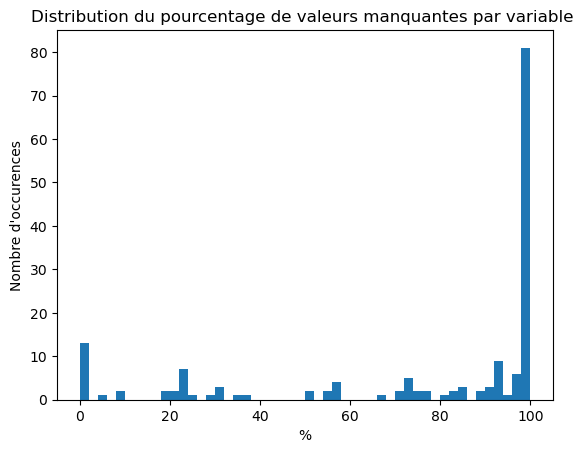

In [6]:
na_percentages = (Open_FF_dataset.isna().sum() / len(Open_FF_dataset)) * 100

sorted_missing_percentage=na_percentages.sort_values(ascending=True)

plt.hist(np.asarray(sorted_missing_percentage),bins=50)
plt.title("Distribution du pourcentage de valeurs manquantes par variable ")
plt.xlabel("%")
plt.ylabel("Nombre d'occurences")
plt.show()


## Choix de la variable cible  : pnns_groups_1

`pnns_groups_1` représente les grandes catégories alimentaires, ce qui offre une vue d'ensemble significative sur la classification nutritionnelle des produits. Cela aide les utilisateurs et les chercheurs à comprendre rapidement le type de produit en termes de valeur nutritionnelle. Avec 71.46% de valeurs manquantes, le choix de cette variable comme cible pour l'imputation permet de relever un défi important en matière de qualité des données, tout en offrant une opportunité d'affiner les méthodes d'imputation basées sur les données nutritionnelles disponibles.

In [7]:
# Identifier la feature cible avec moins de 50% de valeurs présentes
target_feature = 'pnns_groups_1'

# Vérifier le pourcentage de valeurs présentes dans la feature cible
target_present_percentage = Open_FF_dataset[target_feature].count() / len(Open_FF_dataset) * 100
print("Pourcentage de valeurs manquantes de la variable cible: ",100-target_present_percentage)
# Si le pourcentage est inférieur à 50%, vous pouvez continuer
if target_present_percentage < 50:
    # Supprimer les lignes ayant des valeurs manquantes dans la feature cible
    Open_FF_dataset.dropna(subset=[target_feature], inplace=True)
    
    # Séparer la cible du reste du dataset
    target = Open_FF_dataset[target_feature]
    features = Open_FF_dataset.drop(columns=[target_feature])
    
    print("Lignes n'ayant pas de valeur cible ont été supprimées.")
    print("La cible a été séparée du reste du dataset.")
else:
    print("La feature cible a plus de 50% de valeurs présentes. Choisissez une autre cible.")


Pourcentage de valeurs manquantes de la variable cible:  71.46905689789556
Lignes n'ayant pas de valeur cible ont été supprimées.
La cible a été séparée du reste du dataset.


### Sélection des features pour la prédiction de la variable pnns_groups_1


In [8]:
selected_features = [col for col in Open_FF_dataset.columns if col.endswith('100g') 
                     and Open_FF_dataset[col].notna().sum() / len(Open_FF_dataset) >= 0.5
                     and col not in ['nutrition-score-fr_100g', 'nutrition-score-uk_100g','energy_100g']]


# Filtrer les features qui ont un taux de remplissage supérieur à 50%
selected_features = [feature for feature in selected_features if filling_rates[feature] > 50]

# Afficher les features sélectionnées
print("\nFeatures sélectionnées pour la prédiction de la cible :")
print(selected_features)


Features sélectionnées pour la prédiction de la cible :
['fat_100g', 'saturated-fat_100g', 'carbohydrates_100g', 'sugars_100g', 'proteins_100g', 'salt_100g', 'sodium_100g']


Les variables choisies (`fat_100g`, `saturated-fat_100g`, `carbohydrates_100g`, `sugars_100g`, `proteins_100g`, `salt_100g`, `sodium_100g`) représentent les principaux composants nutritionnels qui caractérisent un aliment. Ces mesures sont essentielles pour évaluer la qualité nutritionnelle des produits. Ces variables sont généralement bien renseignées pour la majorité des produits dans Open Food Facts, ce qui les rend particulièrement utiles pour l'imputation des catégories de produits manquantes.

### Automatisation des précédentes étapes dans une seule fonction : 

In [9]:
import pandas as pd
import numpy as np

def preprocess_dataset(df):
    # Afficher les taux de remplissage des features
    filling_rates = (df.count() / len(df)) * 100
    print("Taux de remplissage des features :\n", filling_rates)

    # Sélectionner les features intéressantes pour la prédiction de la cible
    selected_features = [col for col in df.columns if col.endswith('100g') 
                         and df[col].notna().sum() / len(df) >= 0.5
                         and col not in ['nutrition-score-fr_100g', 'nutrition-score-uk_100g','energy_100g']]


    # Supprimer les lignes n'ayant pas de valeur cible
    target_feature = 'pnns_groups_1'
    df.dropna(subset=[target_feature], inplace=True)

    # Séparer la cible du reste du dataset
    target = df[target_feature]
    features = df[selected_features]

    return features, target

# Utilisation de la fonction
features, target = preprocess_dataset(Open_FF_dataset)


Taux de remplissage des features :
 code                       100.000000
url                        100.000000
creator                     99.997815
created_t                  100.000000
created_datetime            99.998907
                              ...    
carbon-footprint_100g        0.292855
nutrition-score-fr_100g     67.535760
nutrition-score-uk_100g     67.535760
glycemic-index_100g          0.000000
water-hardness_100g          0.000000
Length: 162, dtype: float64


# Étape 2 : Identifiez et traitez les valeurs aberrantes

## Visualisation des valeurs aberrantes

Selon notre seléction de features, les valeurs aberrantes sont définis ici comme les valeurs négatives et celles au dessus de 100g.

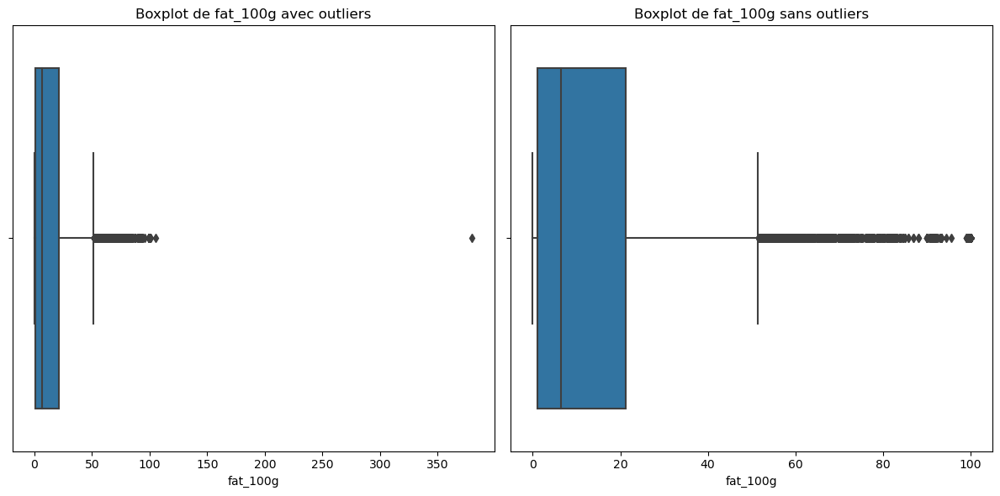

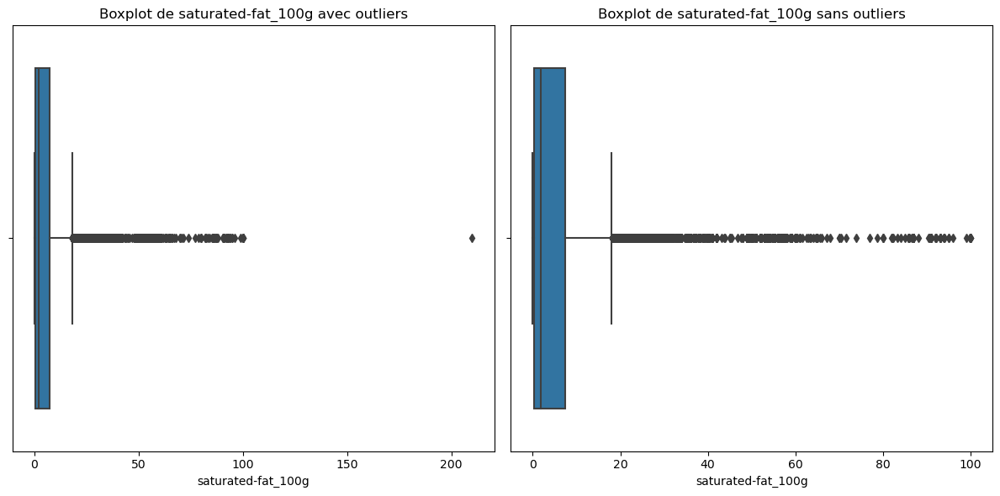

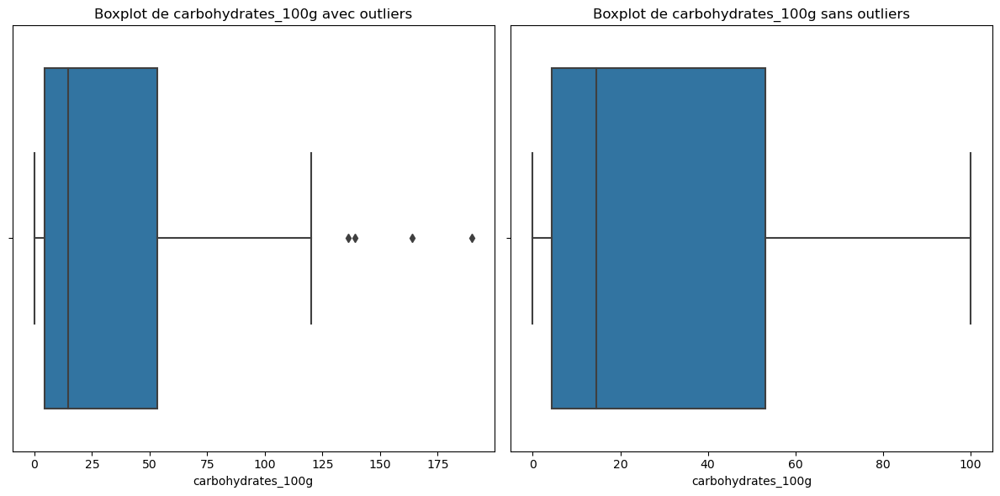

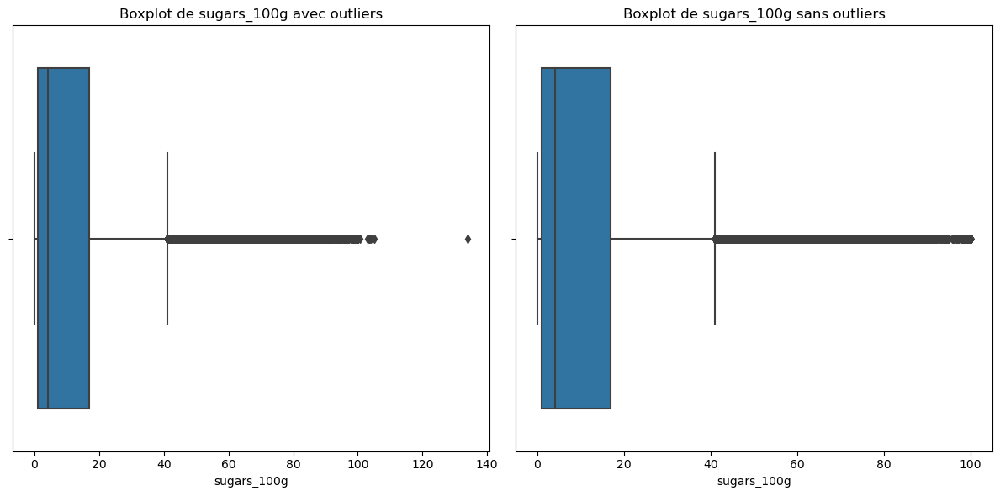

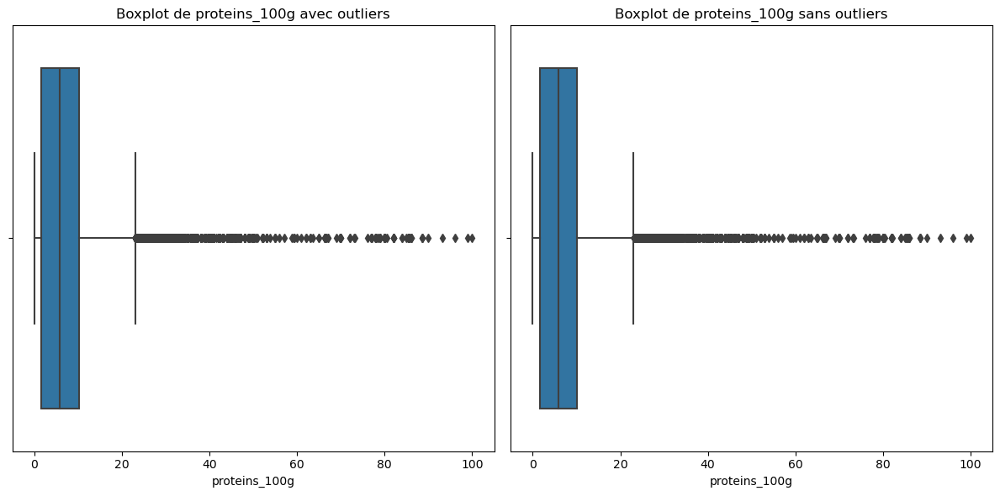

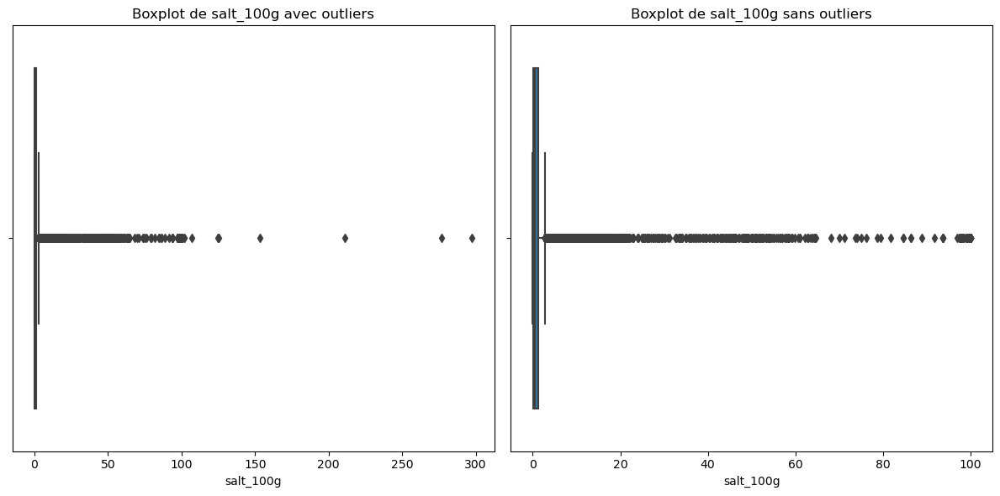

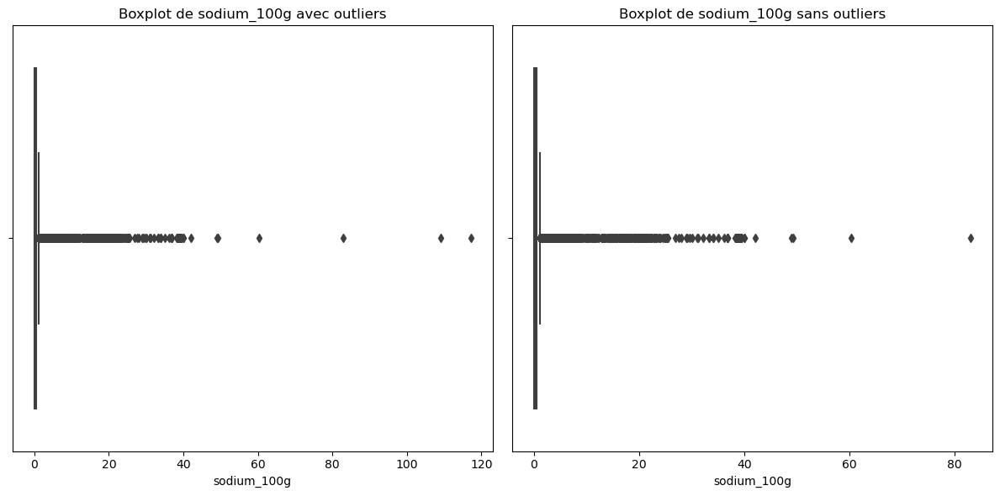

In [10]:
import seaborn as sns
import matplotlib.pyplot as plt

def detect_outliers(df, feature):

    outliers = df[(df[feature] < 0) | (df[feature] > 100)]
    
    return outliers

def plot_boxplots(df, feature):
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    sns.boxplot(x=feature, data=df)
    plt.title(f'Boxplot de {feature} avec outliers')
    
    plt.subplot(1, 2, 2)
    sns.boxplot(x=feature, data=df.drop(detect_outliers(df, feature).index))
    plt.title(f'Boxplot de {feature} sans outliers')
    
    plt.tight_layout()
    plt.show()

# Utilisation de la fonction pour tracer les boxplots
for feature in selected_features:
    plot_boxplots(Open_FF_dataset, feature)



Ce code définit une fonction detect_outliers pour identifier les valeurs aberrantes dans une colonne donnée, puis une fonction plot_boxplots pour tracer les boxplots avec et sans ces valeurs aberrantes. Ensuite, il boucle sur chaque feature sélectionnée pour tracer les boxplots correspondants.

Nous n'allons pas considérer les valeurs hors inter-quartile de ces variables d'intêret comme des outliers car pour cela peut simplement prendre en compte des produits plus rares.  

### Automatisation de l'étape 2 pour les outliers des variales d'interêt et remplacement des valeurs aberrantes par des valeurs NaN

In [11]:
import seaborn as sns

def detect_outliers_replace_nan(df, selected_features):
    outliers_dict = {}
    for feature in selected_features:
        # Identification des valeurs aberrantes (y compris les NaN)
        outliers =  df[(df[feature] < 0) | (df[feature] > 100)]
        
        # Remplacement des outliers par des NaN
        df.loc[outliers.index, feature] = np.nan
        
        # Stockage des valeurs aberrantes dans un dictionnaire
        outliers_dict[feature] = outliers
        
        # Affichage du nombre de valeurs aberrantes identifiées
        print(f"Nombre de valeurs aberrantes identifiées pour {feature} : {len(outliers)}")
        
    return df, outliers_dict

# Utilisation de la fonction
Open_FF_dataset, outliers_dict = detect_outliers_replace_nan(Open_FF_dataset, selected_features)



Nombre de valeurs aberrantes identifiées pour fat_100g : 3
Nombre de valeurs aberrantes identifiées pour saturated-fat_100g : 1
Nombre de valeurs aberrantes identifiées pour carbohydrates_100g : 14
Nombre de valeurs aberrantes identifiées pour sugars_100g : 10
Nombre de valeurs aberrantes identifiées pour proteins_100g : 0
Nombre de valeurs aberrantes identifiées pour salt_100g : 9
Nombre de valeurs aberrantes identifiées pour sodium_100g : 2


Cette fonction détecte les outliers pour les variables d'intérêt, les remplace par des valeurs NaN dans le DataFrame original et renvoie également un dictionnaire contenant les outliers détectés pour chaque variable.

### Traitement de valeurs sur la variable cible 'pnns_groups_1'

Il existe pour la variable pnns_groups_1 des noms de catégories mal renseignées, des doublons si on veut de paires de catégories  avec 'sugary-snacks' et 'Sugary Snacks', ou 'salty-snacks' et 'Salty Snacks'. Nous allons donc renommer les catégories dans 'pnns_groups_1' pour leur homonyme avec majuscule. Nous le faisons dans ce sens car les versions avec majuscule et sans tirets sont bien plus nombreuses en valeurs.

In [12]:

Open_FF_dataset['pnns_groups_1'] = Open_FF_dataset['pnns_groups_1'].replace({
    'salty-snacks': 'Salty snacks',
    'sugary-snacks': 'Sugary snacks',
    'fruits-and-vegetables':'Fruits and vegetables',
    'cereals-and-potatoes':'Cereals and potatoes'
})

On enlève la catégorie 'unknown' de pnns_groups_1 car cette "catégorie" est inutilisable dans notre analyse.

In [13]:
# Remove the 'unknown' type of product
Open_FF_dataset = Open_FF_dataset[Open_FF_dataset['pnns_groups_1'] != 'unknown']

# Étape 3 : Identifiez et traitez les valeurs manquantes

Ce code ci-dessous effectue plusieurs étapes d'analyse et de traitement des données à l'aide de la bibliothèque Python matplotlib, pandas et numpy.

1. Suppression des données de type produit "inconnu" de l'ensemble de données Open_FF_dataset.
2. Visualisation des données et identification des valeurs aberrantes pour les trois principales catégories de produits alimentaires (pnns_groups_1).
3. Initialisation d'un imputeur KNN (k-nearest neighbors) pour remplacer les valeurs manquantes dans les données.
4. Pour chaque catégorie de produits alimentaires les plus fréquentes :
   - Extraction des données de ce groupe spécifique.
   - Imputation des valeurs manquantes dans ces données en utilisant l'imputeur KNN.
   - Visualisation des données avant et après l'imputation (avec une méthode de remplissage par la moyenne pour la comparaison) à l'aide d'histogrammes.
   - Calcul des statistiques descriptives (moyenne, médiane, écart type) avant et après l'imputation.
   - Visualisation des données après l'imputation KNN avec un histogramme et calcul des statistiques descriptives correspondantes.
   

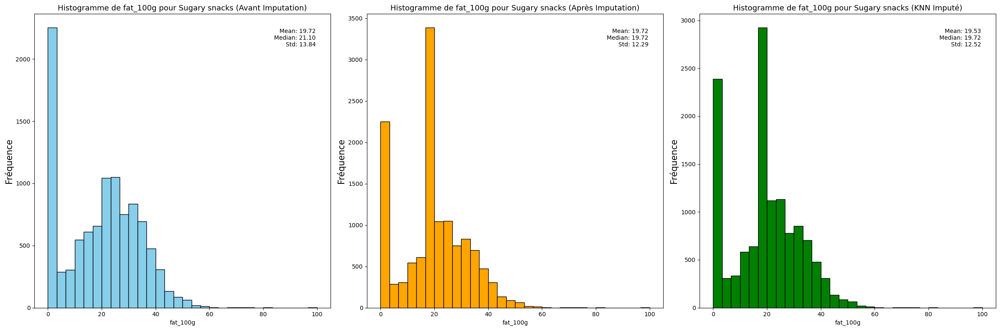

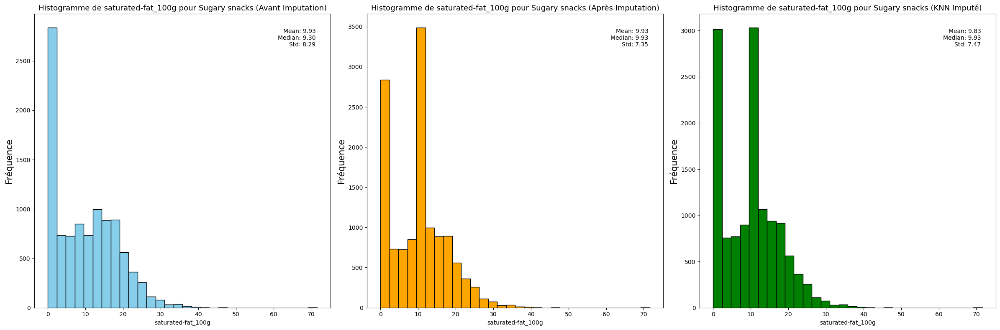

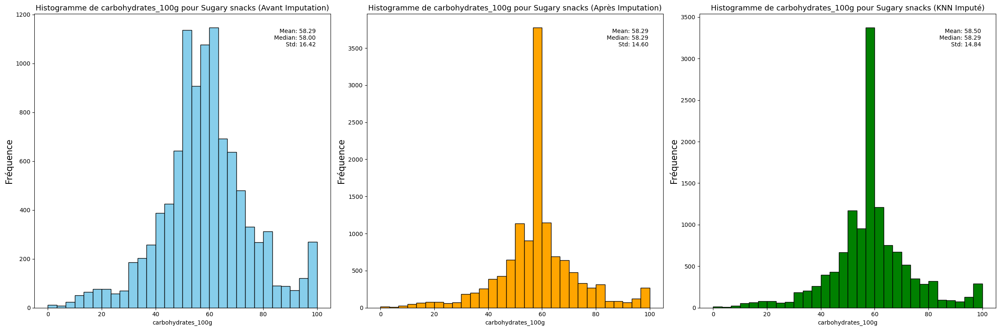

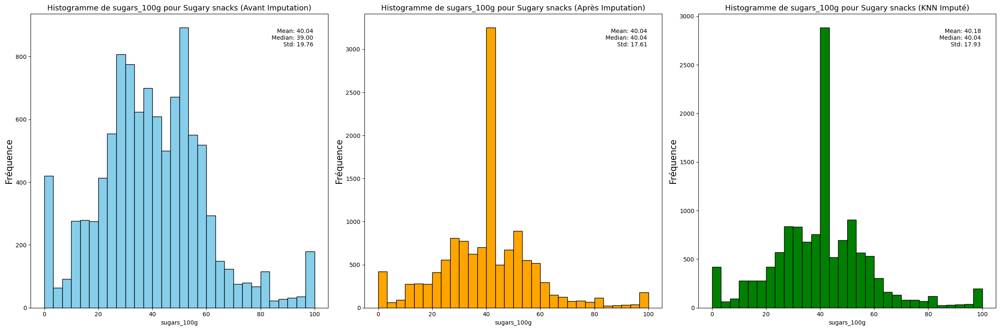

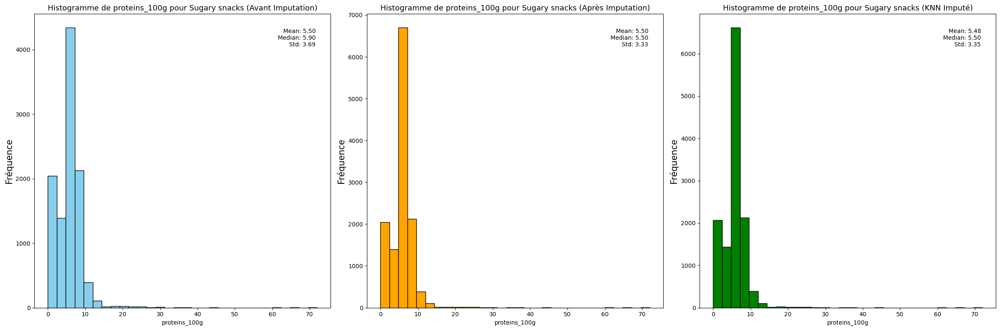

...

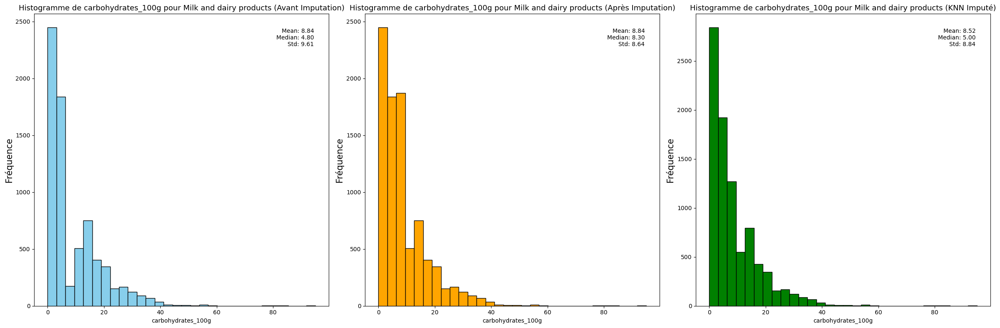

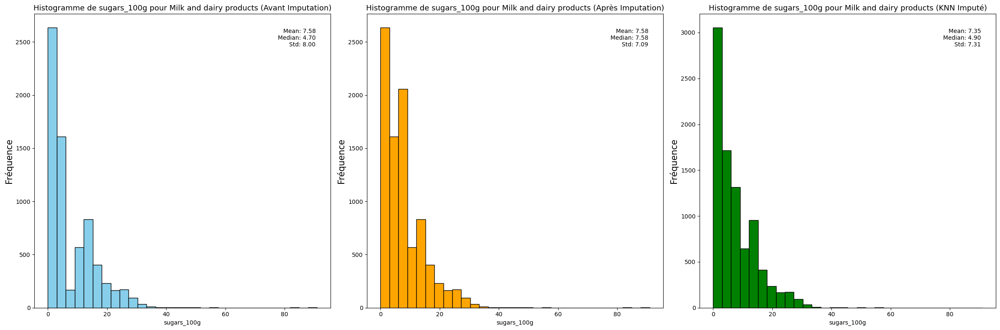

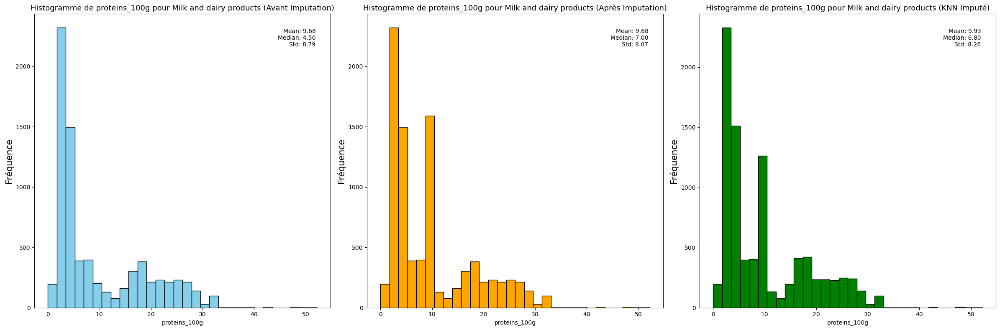

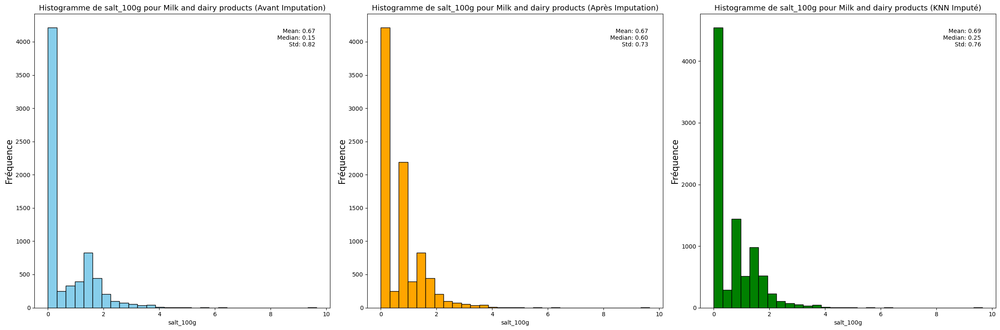

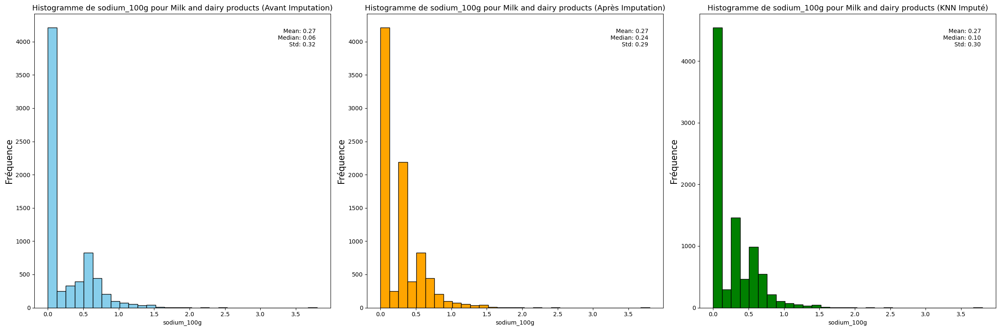

In [14]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.impute import KNNImputer


# Step 1: Visualize the data and identify outliers
top_pnns_groups_1 = Open_FF_dataset['pnns_groups_1'].value_counts().head(3).index.tolist()

# Initialize KNN imputer
knn_imputer = KNNImputer(n_neighbors=8)  # You can adjust the number of neighbors as needed

for pnns_group in top_pnns_groups_1:
    
    group_data = Open_FF_dataset[Open_FF_dataset['pnns_groups_1'] == pnns_group]
    group_data_imputed = knn_imputer.fit_transform(Open_FF_dataset[Open_FF_dataset['pnns_groups_1'] == pnns_group][selected_features])
    
    # Convert the NumPy array back to a DataFrame
    group_data_knn_imputed = pd.DataFrame(group_data_imputed, columns=selected_features)
    for column in selected_features:
        
        plt.figure(figsize=(24, 8))
        plt.subplot(1, 3, 1)
        plt.hist(group_data[column].dropna(), bins=30, color='skyblue', edgecolor='black')
        plt.title(f'Histogramme de {column} pour {pnns_group} (Avant Imputation)', fontsize=13)
        plt.xlabel(column)
        plt.ylabel('Fréquence',fontsize=15)

        # Calculate mean, median, and standard deviation
        mean_val = group_data[column].dropna().mean()
        median_val = group_data[column].dropna().median()
        std_val = group_data[column].dropna().std()

        # Add text to the plot
        plt.text(0.95, 0.95, f'Mean: {mean_val:.2f}\nMedian: {median_val:.2f}\nStd: {std_val:.2f}',
                 horizontalalignment='right', verticalalignment='top', transform=plt.gca().transAxes,fontsize=10)

        
        
        
        # Step 2: Perform mean imputation
        group_data_imputed = group_data.copy()
        group_data_imputed[column].fillna(group_data[column].dropna().mean(), inplace=True)

        # Step 3: Visualize the data after imputation
        plt.subplot(1, 3, 2)
        plt.hist(group_data_imputed[column], bins=30, color='orange', edgecolor='black')
        plt.title(f'Histogramme de {column} pour {pnns_group} (Après Imputation)', fontsize=13)
        plt.xlabel(column)
        plt.ylabel('Fréquence',fontsize=15)

        # Calculate mean, median, and standard deviation after imputation
        mean_val_imputed = group_data_imputed[column].mean()
        median_val_imputed = group_data_imputed[column].median()
        std_val_imputed = group_data_imputed[column].std()
          # Add text to the plot after imputation
        plt.text(0.95, 0.95, f'Mean: {mean_val_imputed:.2f}\nMedian: {median_val_imputed:.2f}\nStd: {std_val_imputed:.2f}',
                 horizontalalignment='right', verticalalignment='top', transform=plt.gca().transAxes,fontsize=10)
        
        
        
        # Plot imputed data
        plt.subplot(1, 3, 3)
        plt.hist(group_data_knn_imputed[column], bins=30, color='green', edgecolor='black')
        plt.title(f'Histogramme de {column} pour {pnns_group} (KNN Imputé)', fontsize=13)
        plt.xlabel(column)
        plt.ylabel('Fréquence',fontsize=15)
        # Calculate mean, median, and standard deviation before imputation
        knn_mean_val_imputed = group_data_knn_imputed[column].mean()
        knn_median_val_imputed = group_data_knn_imputed[column].median()
        knn_std_val_imputed = group_data_knn_imputed[column].std()

        # Add text to the plot after imputation
        plt.text(0.95, 0.95, f'Mean: {knn_mean_val_imputed:.2f}\nMedian: {knn_median_val_imputed:.2f}\nStd: {knn_std_val_imputed:.2f}',
                 horizontalalignment='right', verticalalignment='top', transform=plt.gca().transAxes,fontsize=10)
        

        plt.tight_layout()
        plt.show()



Nous avons remarqué que lors de l'imputation par la moyenne des produits par composition, la plupart des distributions ont été modifiées, avec un pic autour de la moyenne initiale correspondante. Cela suggère que le comportement global des distributions est simplement renforcé autour de la moyenne de l'échantillon. En revanche, en utilisant l'imputation KNN avec 8 groupes (choix arbitraire) par type de produits présents dans pnns_groups_1, nous avons constaté un schéma similaire avec un pic autour de la moyenne. Cependant, nous avons observé que dans ce cas, beaucoup moins de valeurs étaient concentrées dans le pic, et étaient plutôt réparties sur d'autres endroits de la distribution. En conséquence, la distribution globale est généralement davantage respectée. À la lumière de ces résultats, nous envisageons de poursuivre avec l'imputation KNN pour la suite du projet, car elle semble mieux préserver la structure des distributions des données.

In [15]:
def impute_missing_values_mean_by_group(df, selected_features, group_column):
    imputed_counts = {}  # Dictionary to store the count of imputed values per group
    total_imputed_count = 0  # Total count of imputed values across all groups
    
    # Group by the specified column
    grouped = df.groupby(group_column)
    
    # Iterate over groups
    for group_name, group_data in grouped:
        # Perform mean imputation for each selected feature
        for feature in selected_features: 
            mean_value = np.mean(group_data[feature].dropna())
            
            # Count the number of imputed values for this group and feature
            num_imputed_values = group_data[feature].isnull().sum()
            # Fill NaN values by the corresponding mean value of the group
            group_data[feature] = group_data[feature].fillna(mean_value)
            
            # Update the count of imputed values for this group
            imputed_counts.setdefault(group_name, 0)  # Initialize count to 0 if not exist
            imputed_counts[group_name] += num_imputed_values
            
            # Update the total count of imputed values
            total_imputed_count += num_imputed_values
    
    # Concatenate all group_data back to a single DataFrame
    df_imputed = pd.concat([group_data for _, group_data in grouped])
    
    return df_imputed, imputed_counts, total_imputed_count


def impute_missing_values_knn_by_group(df, selected_features, group_column):
    # Group by the specified column
    grouped = df.groupby(group_column)
    
    # Initialize an empty list to store imputed data frames
    imputed_dfs = []
    
    # Initialize KNN imputer
    knn_imputer = KNNImputer(n_neighbors=8) 
    
    # Iterate over groups
    for group_name, group_data in grouped:
        # Perform mean imputation for each selected feature
        group_data_imputed = knn_imputer.fit_transform(group_data[selected_features])
        group_data_knn_imputed = pd.DataFrame(group_data_imputed, columns=selected_features)
        
        # Assign group column with group_name
        group_data_knn_imputed[group_column] = group_name
        
        # Append imputed data frame to the list
        imputed_dfs.append(group_data_knn_imputed)
            
    # Concatenate all imputed data frames back into a single DataFrame
    df_imputed = pd.concat(imputed_dfs)
    
    return df_imputed




Ci-dessous on appelle  les deux fonctions afin d'imputer les valeurs manquantes, par moyenne puis par KNN.

In [16]:
Open_FF_dataset_knn_imputed=impute_missing_values_knn_by_group(Open_FF_dataset, selected_features, 'pnns_groups_1')
Open_FF_dataset_mean_imputed, imputed_counts, total_imputed_count =impute_missing_values_mean_by_group(Open_FF_dataset, selected_features, 'pnns_groups_1')

In [17]:
imputed_counts

{'Beverages': 21848,
 'Cereals and potatoes': 9812,
 'Composite foods': 6288,
 'Fat and sauces': 9401,
 'Fish Meat Eggs': 17283,
 'Fruits and vegetables': 17165,
 'Milk and dairy products': 11848,
 'Salty snacks': 2922,
 'Sugary snacks': 18657}

In [18]:
total_imputed_count

115224

Nous avons pu donc être capable d'imputer un certain nombre de données : maintenant nous allons visualiser notrer ensemble de données dont les imputations pour voir divers comportements et corrélations entre les variables ou juste vis-à-vis de notre  variable cible.

# Etape 4 : Analyse univariée et bivariée

Après avoir remplacé nos valeurs manquantes par une imputation KNN, nous allons désormais faire une analyse univariée et bivariée de notre seléction de variables. La liste de variables est remise ci-dessous :

## Analyse univariée

Pour l'analyse univariée, nous avons choisi pour chaque feature de notre seléction un histogramme, un boxplot et diagramme de densité de distribution.
En effet : Le choix d'utiliser un histogramme, un diagramme en boîte et un graphique de densité pour chaque feature dans notre sélection offre une analyse univariée complète et détaillée. Les histogrammes permettent de visualiser la distribution des valeurs et leur fréquence, tandis que les diagrammes en boîte fournissent des informations sur les quartiles, la médiane et les valeurs aberrantes éventuelles. Les graphiques de densité offrent une représentation lisse de la distribution, mettant en évidence les tendances centrales et les variations. En combinant ces trois types de visualisations, nous obtenons une compréhension approfondie de la répartition des données pour chaque feature, ce qui est essentiel pour l'analyse exploratoire et la prise de décision dans le processus d'analyse des données.

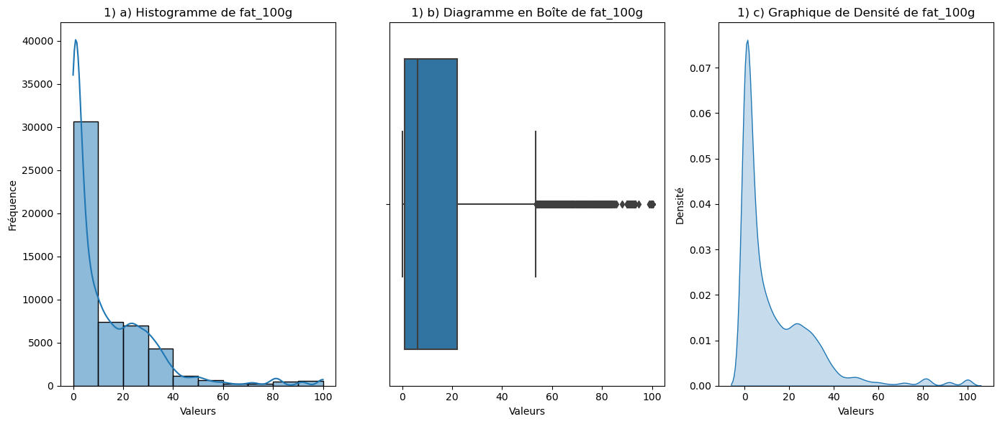

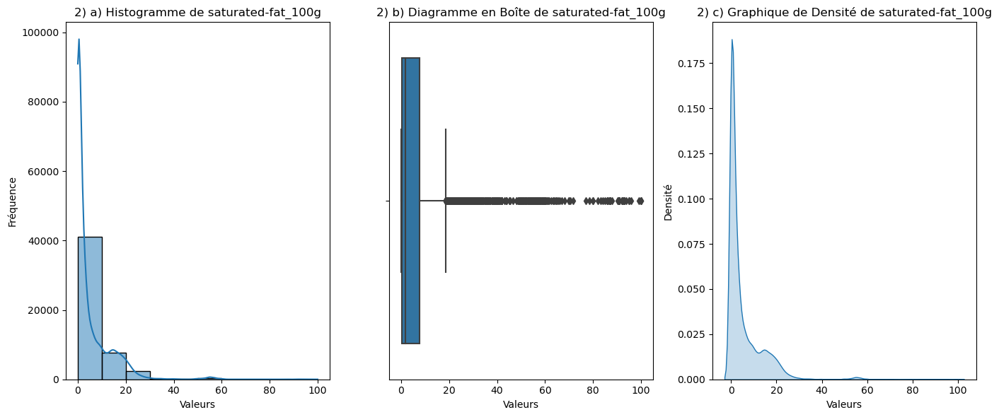

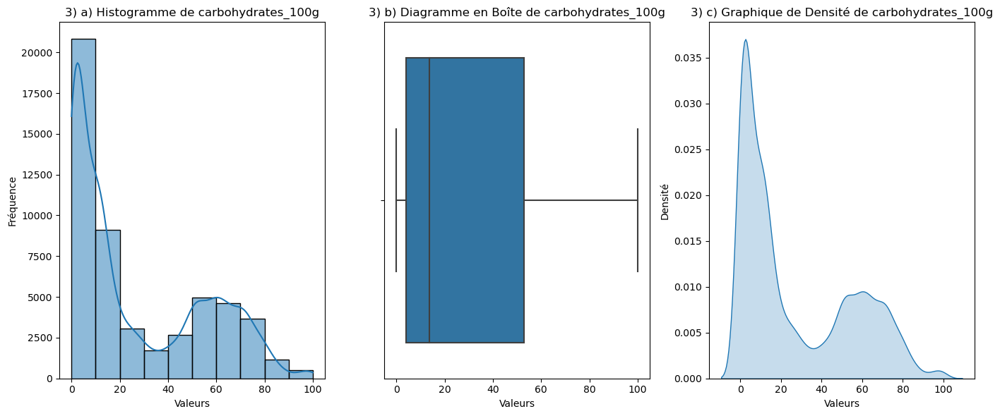

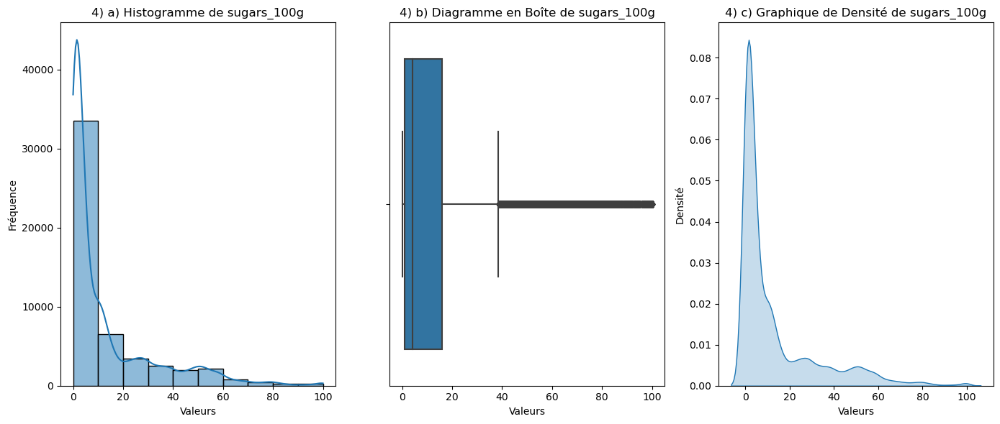

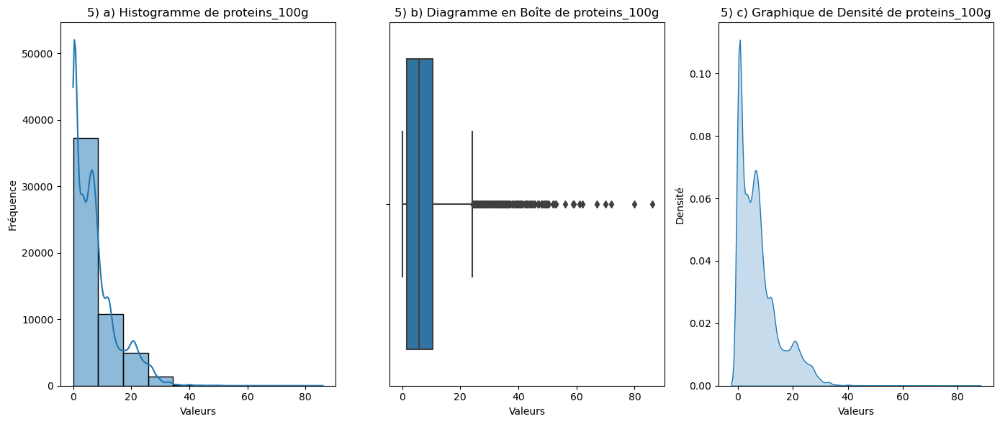

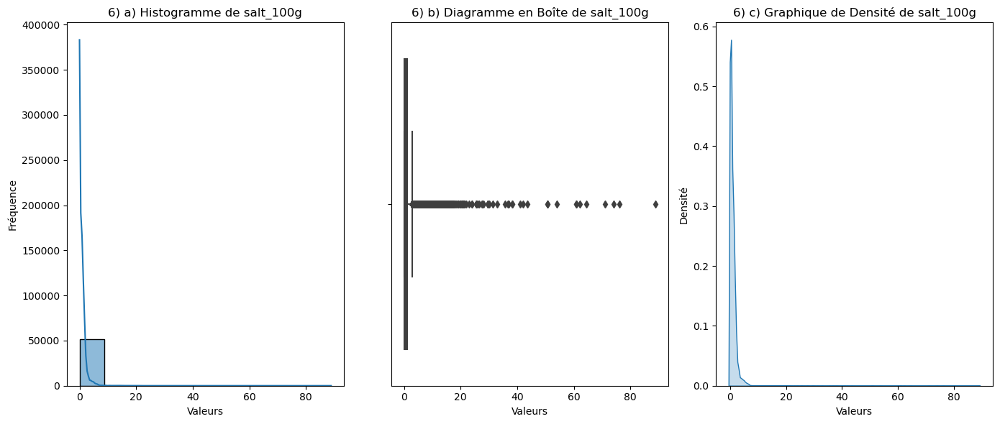

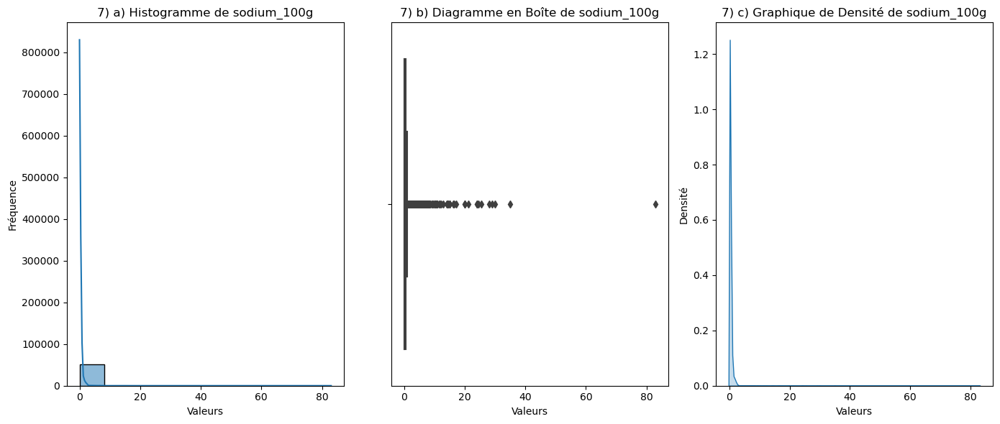

In [19]:
# Boucle sur chaque feature
for i, feature in enumerate(selected_features, start=1):
    plt.figure(figsize=(14, 6))
    
    # Histogramme
    plt.subplot(1, 3, 1)
    sns.histplot(Open_FF_dataset[feature], bins=10, kde=True)
    plt.title(f'{i}) a) Histogramme de {feature}')
    plt.xlabel('Valeurs')
    plt.ylabel('Fréquence')
    
    # Diagramme en boîte
    plt.subplot(1, 3, 2)
    sns.boxplot(x=Open_FF_dataset[feature])
    plt.title(f'{i}) b) Diagramme en Boîte de {feature}')
    plt.xlabel('Valeurs')
    
    # Graphique de densité
    plt.subplot(1, 3, 3)
    sns.kdeplot(Open_FF_dataset[feature], fill=True)
    plt.title(f'{i}) c) Graphique de Densité de {feature}')
    plt.xlabel('Valeurs')
    plt.ylabel('Densité')
    
    plt.tight_layout()
    plt.show()


Nous définissons ci-dessous une fonction afin d'identifier le genre de produits présents dans les outliers observées dans les diagrammes en boîte, avec compte associés par type de produits

In [20]:
def id_outliers(df,feature,cible):

    # Calcul des quartiles et de l'IQR pour "fat_100g"
    Q1 = df['fat_100g'].quantile(0.25)
    Q3 = df['fat_100g'].quantile(0.75)
    IQR = Q3 - Q1

    # Calcul des limites extérieures
    L_sup = Q3 + 1.5 * IQR

    # Identification des valeurs aberrantes
    aberrant_values = df[df[feature] > L_sup]

    # Comptage des outliers par type de produits
    outliers_by_product_type = aberrant_values.groupby(cible).size()

    print("Nombre d'outliers par type de produits pour {feature}:")
    print(outliers_by_product_type)
    


### Commentaires sur les graphiques : 

- 1) <strong>fat_100g</strong> : D'après les différents graphiques, nous pouvons observer que la plupart des valeurs présentes pour fat_100g sont centrées autour de zéro, avec un comportement en demi-cloche type gaussienne notés sur 1)a) et 1)c). Plus on s'éloigne de zéro et de moins en moins de produits sont représentés. Le graphique type diagramme en boîte 1)b) nous montre un certain nombre d'outliers sont présents - les produits rares mentionnés plus tôt se situant ici de 50g à 100g de 'fat'. On peut utliser la fonctions id_outliers pour vérifier le type de produits présents :  


In [21]:
id_outliers(Open_FF_dataset,'fat_100g','pnns_groups_1')

Nombre d'outliers par type de produits pour {feature}:
pnns_groups_1
Beverages                     1
Cereals and potatoes         38
Composite foods               1
Fat and sauces             1478
Fish Meat Eggs               31
Fruits and vegetables        37
Milk and dairy products       6
Salty snacks                176
Sugary snacks                39
dtype: int64


On observe donc que les outliers les plus présents  par catégories sont donc bien provenant de produits très souvent gras, ici les 'Salty snacks' et 'Fat and sauces'. Donc tout va bien, les comportements des différents graphiques sont attendus.

- 2) <strong>saturated-fat_100g</strong> : D'après les différents graphiques, nous pouvons observer que les mêmes comportements que pour 'fat_100g', c'est attendu, car 'saturated-fat_100g' et 'fat_100g' vont souvent de paires, étant tout deux des matières grasses. Avec le graphique 2)b), la seule différence est que nous avons moins de 'valeurs aberrantes' ou d'outliers que pour 'fat_100g', normal les graisses saturées sont plus rares que le gras tout court dans les produits alimentaires. Nous ferons donc les mêmes commentaires que précedemment : comportements en demi-cloche type gaussienne centrée sur zéro. En utilisant de nouveau la fonction id_outliers : 

In [22]:
id_outliers(Open_FF_dataset,'saturated-fat_100g','pnns_groups_1')

Nombre d'outliers par type de produits pour {feature}:
pnns_groups_1
Beverages                  1
Fat and sauces           338
Fruits and vegetables     16
Salty snacks               1
Sugary snacks              1
dtype: int64


On observe donc que les outliers sont de même type de produits encore : 'Fat and sauces' pour le plus récurrent .

- 3) <strong>carbohydrates_100g</strong> : D'après les différents graphiques, nous pouvons observer un comportement différent que pour 'fat_100g' ou bien 'saturated-fat_100g'. Les comportements observés sur 3)a) et 3)c) sont attendus, en effet :
les 'carbohydrates' ou les glucides sont principalement centrée autour de zéro gramme pour les produits qui ne contiennent pas ou très peu de glucides, comme certains produits laitiers ou les viandes. Cependant, on peut également s'attendre à observer une autre distribution, semblable à une cloche gaussienne, centrée autour de 50g pour les produits qui contiennent une quantité significative de glucides, comme les pâtes, le riz, ou les produits de boulangerie. 


- 4) <strong>sugars_100g</strong> : D'après les différents graphiques, nous pouvons observer que les mêmes comportements que pour 'carbohydrates_100g', sauf pour le diagramme en boîte. Pour le sucre (sugars_100g), il s'agit également d'un type de glucide, mais spécifiquement de sucres simples, tels que le glucose, le fructose et le saccharose, qui sont facilement absorbés par l'organisme pour fournir de l'énergie. µOn peut également s'attendre à ce que la distribution des sucres sur 4)a) et 4)c) soit principalement centrée autour de zéro gramme pour les produits qui ne contiennent pas ou très peu de sucres ajoutés, comme certaines viandes et certains légumes. Cependant, la deuxième cloche, centrée autour de 50g, pourrait être plus basse que celle des glucides totaux, car elle représente principalement les sucres ajoutés présents dans les aliments transformés, les boissons sucrées et les produits sucrés. Ces produits peuvent varier considérablement en termes de teneur en sucre ajouté, ce qui peut entraîner une distribution plus étalée et moins concentrée autour de 50g. On peut utliser la fonction id_outliers pour vérifier : 


In [23]:
id_outliers(Open_FF_dataset,'sugars_100g','pnns_groups_1')

Nombre d'outliers par type de produits pour {feature}:
pnns_groups_1
Beverages                   338
Cereals and potatoes         19
Fat and sauces               16
Fruits and vegetables       244
Milk and dairy products       5
Salty snacks                  6
Sugary snacks              2241
dtype: int64


On a bien donc des produits sucrées dnas les outliers tel que les boissons sucrées dans 'Beverages', fruits dans 'Fruits and vegetables' et globablement les produits sucrés dans 'Sugary snacks' les plus récurrents en l'occurence, c'est attendu 

- 5) <strong>proteins_100g</strong> : D'après les différents graphiques , nous pouvons observer que les mêmes comportements que pour 'fat_100g' ou bien  'saturated-fat_100g'. On oberve une distribution des protéines davantage centrée autour de zéro gramme cepdndant, pour les produits qui ne contiennent pas ou très peu de protéines, comme certaines boissons ou certains produits de confiserie, les légumes et les fruits. Vérifions cela avec la fonction id_outliers pour savoir quel type de produits en contiennent davantage de protéines : 


In [24]:
id_outliers(Open_FF_dataset,'proteins_100g','pnns_groups_1')

Nombre d'outliers par type de produits pour {feature}:
pnns_groups_1
Beverages               1
Cereals and potatoes    2
Fish Meat Eggs          1
Salty snacks            1
Sugary snacks           5
dtype: int64


On peut observer beaucoup moins de données dans les outliers, c'est parce que les valeurs pour 'proteins_100g' sont moins remplies. Cependant on oberve bien les produits qui contiennent le plus de protéines dans le catégories 'Fish Meat Eggs' des produits animaliers, c'est attendu. Autrement, pour les autres catégories trouvées dans les outliers :


- Beverages (Boissons) : Il peut s'agir de certaines boissons enrichies en protéines, comme des boissons protéinées ou des substituts de repas.

- Cereals and potatoes (Céréales et pommes de terre) : Il peut s'agir de certains produits à base de céréales enrichies en protéines, comme des barres de céréales riches en protéines ou des chips de pommes de terre au contenu protéiné élevé.

- Milk and dairy products (Produits laitiers) : Il peut s'agir de certains produits laitiers enrichis en protéines, comme des yaourts grecs ou des fromages à teneur protéinique accrue.

- Salty snacks (Snacks salés) : Il peut s'agir de certains snacks salés enrichis en protéines, comme des chips de pois chiches ou des mélanges de noix protéinés.

- Sugary snacks (Snacks sucrés) : Il peut s'agir de certains snacks sucrés enrichis en protéines, comme des barres de céréales sucrées ou des biscuits protéinés.


- 6) <strong>salt_100g</strong> :D'après les différents graphiques, nous pouvons observer une distribution extrêmement centrée autour de zéro d'après 6)a) et 6)c). On peut voir très peu de 'valeurs aberrantes' ou outliers. On peut imaginer que cela provienne des aliments transformés ou les plats préparés qui peuvent contenir des quantités de sel beaucoup plus élevées que les aliments non transformés.Les valeurs aberrantes pour la teneur en sel pourraient être associées à des produits alimentaires très salés, tels que des collations salées, des sauces, des produits de charcuterie ou des soupes en conserve, qui contiennent souvent des quantités de sel ajoutées importantes pour des raisons de conservation ou de saveur.

Vérifions cela avec la fonction id_outliers : 

In [25]:
id_outliers(Open_FF_dataset,'salt_100g','pnns_groups_1')

Nombre d'outliers par type de produits pour {feature}:
pnns_groups_1
Beverages                2
Composite foods          2
Fish Meat Eggs           1
Fruits and vegetables    2
Salty snacks             1
Sugary snacks            1
dtype: int64


Les catégories de produits concernées par les valeurs aberrantes de la teneur en sel (salt_100g) sont les suivantes :

- Beverages (Boissons) : Certaines boissons peuvent contenir des quantités élevées de sel, notamment les boissons énergisantes ou les boissons sportives.
- Composite foods (Aliments composites) : Ce sont des aliments qui contiennent plusieurs ingrédients, et certains d'entre eux peuvent être riches en sel, comme les plats préparés ou les sandwichs.
- Fish Meat Eggs (Poissons, viandes et œufs) : Certains produits à base de viande ou de poisson peuvent être salés, comme les viandes fumées ou les conserves de poisson.
- Fruits and vegetables (Fruits et légumes) : Bien que la plupart des fruits et légumes soient naturellement faibles en sel, certaines préparations ou conserves peuvent contenir des quantités ajoutées de sel.
- Salty snacks (Snacks salés) : Les snacks salés, tels que les chips ou les biscuits salés, sont connus pour leur teneur élevée en sel.
- Sugary snacks (Snacks sucrés) : Même si les snacks sucrés ne sont pas traditionnellement associés à une forte teneur en sel, certains produits peuvent contenir des quantités inattendues de sel ajouté, notamment les collations mixtes sucrées-salées.


- 7) <strong>sodium_100g</strong> : D'après les différents graphiques, nous pouvons observer les mêmes comportements que pour 'salt_100g'. La seule différence est que nous avons moins d'outliers ou 'valeurs aberrantes' que pour 'salt_100g'.
Cela pourrait suggérer que la caractéristique en question est moins sujette à des extrêmes ou à des valeurs aberrantes que la teneur en sel. Cela peut être dû à plusieurs facteurs, tels que la nature des produits eux-mêmes, les pratiques de fabrication, ou les normes réglementaires en matière de composition nutritionnelle.

## Analyse bivariée

Nous allons désormais faire une analyse bivariée, et le but de celle-ci est de déterminer les potentielles corrélations entre notre seléction de variables. Pour cela, nous utiliserons des tests de Pearson avec une matrice de corrélation.

- **Variables :**
- 'fat_100g', 'saturated-fat_100g', 'carbohydrates_100g', 'sugars_100g', 'proteins_100g', 'salt_100g', 'sodium_100g'
- **Analyse :**
- Examiner la relation entre les niveaux de matières grasses, de glucides, de protéines, etc.
- Calculer le coefficient de corrélation entre ces variables pour voir s'il existe des relations linéaires.

Pour calculer le coefficient de corrélation entre deux variables quantitatives, vous pouvez utiliser la méthode `corr()` disponible dans Pandas. Cette méthode calcule par défaut le coefficient de corrélation de Pearson, qui mesure la relation linéaire entre deux variables.

Les cellules ci-dessous calculeront le coefficient de corrélation de Pearson entre deux variables. Nous lancerons ce code sur l'ensemble de combinaisons de variables possible pour cette analyse. Le coefficient de corrélation de Pearson varie de -1 à 1, où :

- Une valeur de 1 indique une corrélation linéaire positive parfaite.
- Une valeur de -1 indique une corrélation linéaire négative parfaite.
- Une valeur de 0 indique qu'il n'y a pas de corrélation linéaire entre les variables.


Ci-dessous, nous créeons la la matrice de corrélation pour notre séléction de features ou chaque valeur correspond au coefficient de Pearson : 

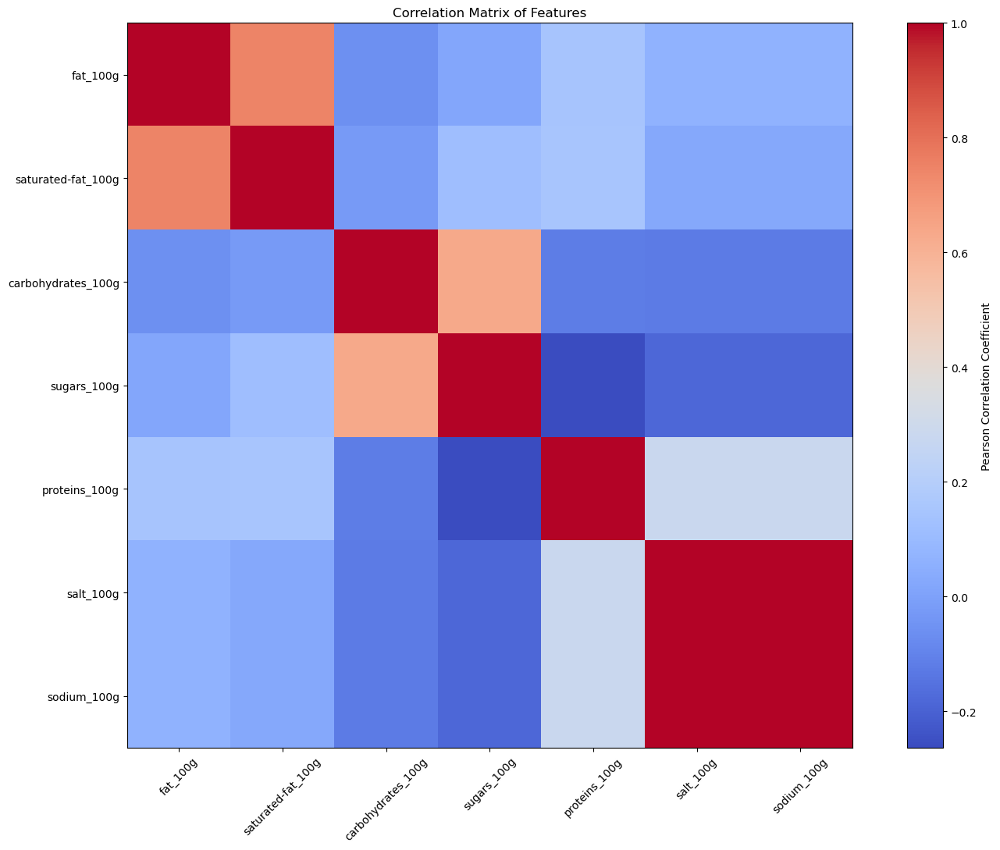

In [26]:
# Calculate correlation matrix
correlation_matrix = Open_FF_dataset[selected_features].dropna().corr()

# Plot correlation matrix
plt.figure(figsize=(15, 11))
plt.imshow(correlation_matrix, cmap='coolwarm', interpolation='nearest')
plt.colorbar(label='Pearson Correlation Coefficient')
plt.title('Correlation Matrix of Features')
plt.xticks(ticks=range(len(selected_features)), labels=selected_features, rotation=45)
plt.yticks(ticks=range(len(selected_features)), labels=selected_features)
plt.tight_layout()
plt.show()

### Commentaires : 

#### Corrélation entre fat_100g et saturated-fat_100g

Une corrélation assez forte entre les variables 'fat_100g' et 'saturated-fat_100g' peut être due à plusieurs facteurs :

1. **Nature des nutriments :** Les graisses saturées sont un type spécifique de graisses présentes dans de nombreux aliments riches en matières grasses. Comme 'fat_100g' représente la quantité totale de graisses dans un produit alimentaire et 'saturated-fat_100g' représente la quantité de graisses saturées, il est naturel qu'il y ait une corrélation entre ces deux variables, car les aliments riches en matières grasses tendent également à être riches en graisses saturées.

2. **Composition des aliments :** De nombreux aliments riches en matières grasses, tels que les produits laitiers, les viandes grasses et les produits de boulangerie, contiennent à la fois des graisses totales et des graisses saturées. Par conséquent, la présence de graisses totales dans un aliment est souvent accompagnée d'une quantité proportionnelle de graisses saturées, ce qui entraîne une corrélation entre ces deux variables.

3. **Formulation alimentaire :** Les fabricants d'aliments peuvent formuler leurs produits de manière à ce que la quantité de graisses totales soit généralement associée à une proportion similaire de graisses saturées. Cette pratique peut contribuer à une corrélation positive entre 'fat_100g' et 'saturated-fat_100g' dans l'ensemble des produits.

En résumé, la corrélation assez forte entre 'fat_100g' et 'saturated-fat_100g' peut être expliquée par la nature et la composition des aliments, ainsi que par les pratiques de formulation alimentaire courantes.

#### Corrélation entre salt_100g et sodium_100g

La corrélation presque parfaite entre les variables 'sodium_100g' et 'salt_100g' peut s'expliquer par le fait que le sel de table (chlorure de sodium) est la principale source de sodium dans l'alimentation humaine. Voici quelques raisons pour lesquelles cette corrélation est si élevée :

1. **Composition chimique :** Le sel de table est principalement composé de sodium et de chlorure. Environ 40 % de la masse du sel de table est constituée de sodium. Par conséquent, toute augmentation de la quantité de sel dans un produit alimentaire entraînera généralement une augmentation proportionnelle de la quantité de sodium.

2. **Relation de proportion :** La relation entre le sodium et le sel dans les aliments est généralement proportionnelle. Par exemple, les aliments qui contiennent plus de sel auront également tendance à contenir plus de sodium. Cela crée une forte corrélation linéaire entre les deux variables.

3. **Pratiques de mesure :** Les données nutritionnelles sur les étiquettes des aliments fournissent généralement des informations sur la quantité de sodium et de sel par portion. Les valeurs sont souvent mesurées et rapportées de manière similaire, ce qui renforce la corrélation entre les deux variables.

En résumé, la corrélation presque parfaite entre 'sodium_100g' et 'salt_100g' s'explique par la composition chimique du sel de table, la relation de proportion entre le sodium et le sel dans les aliments, ainsi que par les pratiques de mesure et de rapport des données nutritionnelles.

Nous pourrions décider de mettre la valeur de l'un par l'autre en cas de valeurs manquantes grâce au code suivant : 

In [27]:
# Replace missing values in 'salt_100g' with corresponding values from 'sodium_100g'
Open_FF_dataset_knn_imputed['salt_100g'].fillna(Open_FF_dataset_knn_imputed['sodium_100g'], inplace=True)

# Replace missing values in 'sodium_100g' with corresponding values from 'salt_100g'
Open_FF_dataset_knn_imputed['sodium_100g'].fillna(Open_FF_dataset_knn_imputed['salt_100g'], inplace=True)


## Analyse multidimensionnelle :

Ce code a pour objectif de réaliser une analyse en composantes principales (ACP) sur un ensemble de données, ainsi que de visualiser les résultats de l'ACP à l'aide de deux types de graphiques : les projections sur le plan factoriel et les cercles de corrélation.

Voici une description générale des principales étapes effectuées par le code :

1. **Prétraitement des données** :
   - Sélection des caractéristiques d'intérêt à partir de l'ensemble de données.
   - Extraction des groupes PNNS (Programme National Nutrition Santé) à partir des données.

2. **Normalisation des données** :
   - Utilisation de `StandardScaler` pour standardiser les données.

3. **Analyse en Composantes Principales (ACP)** :
   - Application de l'ACP à l'aide de la classe `PCA` de scikit-learn.
   - Calcul des composantes principales et des valeurs propres associées.

4. **Tracé des Cercles de Corrélation** :
   - Visualisation des relations entre les caractéristiques originales et les composantes principales.
   - Tracé des vecteurs de corrélation sur un cercle.

5. **Identification des Meilleures Combinaisons de Caractéristiques** :
   - Calcul des corrélations absolues entre les caractéristiques et les composantes principales.
   - Recherche des meilleures combinaisons de caractéristiques basées sur ces corrélations.

6. **Projection sur le Plan Factoriel** :
   - Pour chaque meilleure combinaison de caractéristiques :
     - Réduction des dimensions des données à l'aide de l'ACP.
     - Projection des données sur un plan factoriel en utilisant les deux premières composantes principales.
     - Coloration des points en fonction des groupes PNNS.

7. **Affichage des Graphiques** :
   - Affichage des graphiques des cercles de corrélation et des projections sur le plan factoriel.

L'objectif principal est de visualiser et d'analyser la structure des données à l'aide de l'ACP, en mettant en évidence les relations entre les caractéristiques et en identifiant les patterns ou groupes potentiels dans les données.tiques pertinentes, ce qui est essentiel pour comprendre et analyser de grands ensembles de données multidimensionnelles.

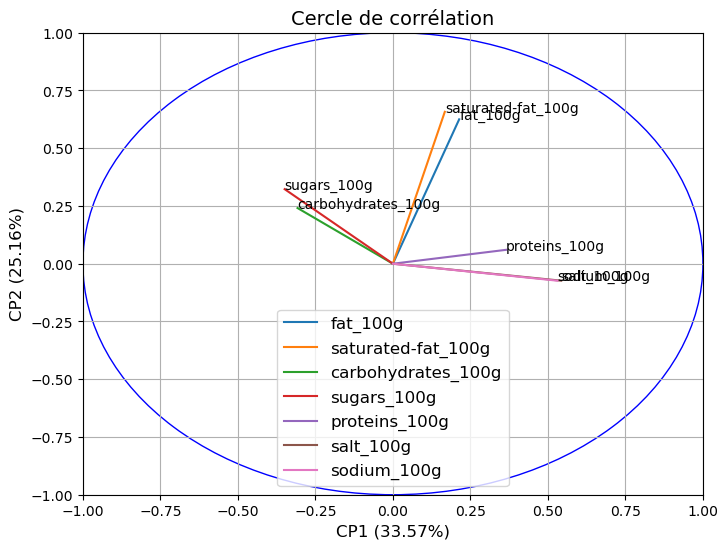

In [79]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from itertools import combinations

def tracer_projection_plan_factoriel(ax, X_scaled, pca, selected_features, combination, groupes):
    # Effectuer l'ACP
    pca.fit(X_scaled)

    # Obtenir les coordonnées des observations dans l'espace des composantes principales
    X_pca = pca.transform(X_scaled)

    # Tracer les projections sur le plan factoriel avec des couleurs en fonction des groupes
    for groupe in np.unique(groupes):
        ax.scatter(X_pca[groupes == groupe, 0], X_pca[groupes == groupe, 1], alpha=0.5, label=f'{groupe}', s=1)
    ax.set_title(f'Projection sur le plan factoriel pour la combinaison : {combination}', fontsize=14)
    ax.set_xlabel(f'CP1 ({pca.explained_variance_ratio_[0]*100:.2f}%)', fontsize=12)
    ax.set_ylabel(f'CP2 ({pca.explained_variance_ratio_[1]*100:.2f}%)', fontsize=12)
    ax.grid(True)
    ax.legend(fontsize=8, handlelength=2.0, handletextpad=1.0,markerscale=4)  # Adjust the handlelength and handletextpad as needed


# Cercles de corrélation
def tracer_cercle_correlation(ax, pc_infos, pc1, pc2, features):
    cercle = plt.Circle((0,0), radius=1, color='b', fill=False)
    ax.add_artist(cercle)
    for i, (coef, feature) in enumerate(zip(pc_infos.components_.T, features)):
        ax.plot([0, coef[pc1]], [0, coef[pc2]], label=feature)
        ax.text(coef[pc1], coef[pc2], feature, fontsize=10)
    ax.set_xlim((-1, 1))
    ax.set_ylim((-1, 1))
    ax.set_xlabel(f'CP{pc1+1} ({pc_infos.explained_variance_ratio_[pc1]*100:.2f}%)', fontsize=12)
    ax.set_ylabel(f'CP{pc2+1} ({pc_infos.explained_variance_ratio_[pc2]*100:.2f}%)', fontsize=12)
    ax.set_title('Cercle de corrélation', fontsize=14)
    ax.grid()
    ax.legend(fontsize=12)

# Configuration des sous-graphiques pour chaque groupe
donnees = Open_FF_dataset_knn_imputed
selected_features = ['fat_100g', 'saturated-fat_100g', 'carbohydrates_100g', 'sugars_100g', 'proteins_100g', 'salt_100g', 'sodium_100g']

# Extraire les caractéristiques pour le groupe actuel
X = donnees[selected_features]

# Extraire les groupes PNNS
groupes = donnees['pnns_groups_1']

# Standardiser les données
scaler = StandardScaler()
X_standardise = scaler.fit_transform(X)

# Effectuer l'ACP
pca = PCA()
pca.fit(X_standardise)

# Tracer le cercle de corrélation pour le groupe actuel
tracer_cercle_correlation(plt.figure(figsize=(8, 6)).gca(), pca, 0, 1, selected_features)

# Obtenir les valeurs de corrélation absolue
cercle_corr = np.abs(pca.components_.T * np.sqrt(pca.explained_variance_))

# Trouver les trois meilleures combinaisons de caractéristiques basées sur le cercle de corrélation
meilleures_combinaisons = []
for i in range(len(selected_features)):
    for j in range(i+1, len(selected_features)):
        for k in range(j+1, len(selected_features)):
            somme_correlation = cercle_corr[i] + cercle_corr[j] + cercle_corr[k]
            meilleures_combinaisons.append((somme_correlation.sum(), [selected_features[i], selected_features[j], selected_features[k]]))

# Trier les combinaisons en fonction de la somme de corrélation
meilleures_combinaisons.sort(reverse=True)

# Obtenir la première meilleure combinaison
meilleure_combinaison_trois = meilleures_combinaisons[0][1]

# Générer toutes les combinaisons de paires possibles
combinaisons_paires = list(combinations(meilleure_combinaison_trois, 2))


# Standardiser les données pour la combinaison actuelle
scaler_combinaison = StandardScaler()
X_standardise_combinaison = scaler_combinaison.fit_transform(X_combinaison)

# Créer un nouvel objet PCA
pca_combinaison = PCA()

# Tracer la projection sur le plan factoriel avec les couleurs des groupes PNNS
tracer_projection_plan_factoriel(plt.figure(figsize=(8, 6)).gca(), X_standardise_combinaison, pca_combinaison, selected_features, combinaison, groupes)

# Affichage
plt.show()



On observe d'après le cercle de corrélation que beaucoup de nos variables sont redondantes pour expliquer la variance de nos données et leur structure sous-jacente. On peut enveler une variable de chaque paire de variables suivantes pour simplifier notre jeu de données et donc notre capacité de prédiction : ["sodium_100g", "salt_100g"] ; ["fat_100g","saturated-fat_100g"] ; ["carbohydrates_100g","sugars_100g"]

Concernant le choix de quel variable parmi les paires nous enlèverons du jeu de données, cela sera celles qui sont le moins renseignées dans le dataset.

In [76]:
import pandas as pd

# Charger le dataset initial
donnees = Open_FF_dataset

# Compter le nombre de valeurs manquantes pour chaque paire de variables
pair1_null_count = [donnees["sodium_100g"].isnull().sum(), donnees["salt_100g"].isnull().sum()]
pair2_null_count = [donnees["fat_100g"].isnull().sum(), donnees["saturated-fat_100g"].isnull().sum()]
pair3_null_count = [donnees["carbohydrates_100g"].isnull().sum(), donnees["sugars_100g"].isnull().sum()]

# Déterminer la variable qui a le moins de valeurs manquantes dans chaque paire
if pair1_null_count[0] < pair1_null_count[1]:
    print("La variable qui a le moins de valeurs manquantes dans la première paire est 'sodium_100g'.")
else:
    print("La variable qui a le moins de valeurs manquantes dans la première paire est 'salt_100g'.")

if pair2_null_count[0] < pair2_null_count[1]:
    print("La variable qui a le moins de valeurs manquantes dans la deuxième paire est 'fat_100g'.")
else:
    print("La variable qui a le moins de valeurs manquantes dans la deuxième paire est 'saturated-fat_100g'.")

if pair3_null_count[0] < pair3_null_count[1]:
    print("La variable qui a le moins de valeurs manquantes dans la troisième paire est 'carbohydrates_100g'.")
else:
    print("La variable qui a le moins de valeurs manquantes dans la troisième paire est 'sugars_100g'.")


La variable qui a le moins de valeurs manquantes dans la première paire est 'salt_100g'.
La variable qui a le moins de valeurs manquantes dans la deuxième paire est 'fat_100g'.
La variable qui a le moins de valeurs manquantes dans la troisième paire est 'carbohydrates_100g'.


 Nous pourrions passer donc de 7 variables désormais à 4 variables pour prédire la classe 'pnns_groups_1' avec :  ['salt_100g', 'fat_100g' , 'proteins_100g' et 'carbohydrates_100g' ]

### PCA: Projection des plan de factorielles 3D interactif des trois composantes principales

Le code ci-dessous nous donne une visualisation 3D interactive sur  la PCA appliqué à trois variables - le trio de variables qui conservent un maximum de variance. Nous colorons ensuite selon chaque groupe de 'pnns_groups_1' afin de voir des potentielles séparations de groups dans la projection de plan factoriel

In [100]:
# Active l'affichage des graphiques directement dans le notebook Jupyter
%matplotlib inline

# Importe les objets graphiques de plotly et la fonction pour créer des sous-graphiques
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Importe le dataset nécessaire
donnees = Open_FF_dataset_knn_imputed

# Sélectionne les caractéristiques à utiliser
selected_features = ['fat_100g', 'saturated-fat_100g', 'carbohydrates_100g', 'sugars_100g', 'proteins_100g', 'salt_100g', 'sodium_100g']

# Extrait les caractéristiques sélectionnées du dataset
X = donnees[selected_features]

# Extrait les groupes PNNS
groupes = donnees['pnns_groups_1']

# Standardise les données pour la combinaison actuelle
scaler_combinaison = StandardScaler()

X_standardise_combinaison = scaler_combinaison.fit_transform(X)

import plotly.graph_objects as go

# Crée un nouvel objet PCA
pca_combinaison = PCA(n_components=3)

# Ajuste le modèle PCA aux données standardisées
pca_combinaison.fit(X_standardise_combinaison)

# Obtient les coordonnées des observations dans l'espace des composantes principales
X_pca = pca_combinaison.transform(X_standardise_combinaison)

# Crée un graphique 3D avec des sous-graphiques
fig = go.Figure(data=[go.Scatter3d(x=X_pca[:, 0], y=X_pca[:, 1], z=X_pca[:, 2],
                                   mode='markers',
                                   marker=dict(size=1, opacity=0.5),
                                   showlegend=False)])

# Ajoute des traces pour la légende uniquement
for groupe in np.unique(groupes):
    fig.add_trace(go.Scatter3d(x=[None],
                               y=[None],
                               z=[None],
                               mode='markers',
                               marker=dict(size=10, opacity=0.5),
                               name=f"{groupe}",
                               legendgroup=f" {groupe}",
                               showlegend=True))

# Met à jour la disposition avec les limites de l'axe z définies sur (0, 30)
fig.update_layout(scene=dict(xaxis_title='Composante 1',
                             xaxis=dict(range=[0, 10]),
                             yaxis_title='Composante 2',
                             zaxis_title='Composante 3',
                             zaxis=dict(range=[0, 20])),
                  legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="right", x=1))

# Ajoute des traces pour chaque groupe
for groupe in np.unique(groupes):
    fig.add_trace(go.Scatter3d(x=X_pca[groupes == groupe, 0],
                               y=X_pca[groupes == groupe, 1],
                               z=X_pca[groupes == groupe, 2],
                               mode='markers',
                               marker=dict(size=1, opacity=0.5),
                               name=f"{groupe}",
                               legendgroup=f" {groupe}",
                               showlegend=False))

# Affiche le graphique
fig.show()



Nous observons clairement des séparations entre groupe de 'pnns_groups_1' sur le plot interactif précédent , nous avons une base de travail solide pour continuer sur des prédictions de groupe d'un produit à partir des valeurs de nos selection de variables correspondantes.

## Test d'ANOVA 

Un test d'analyse de variance (ANOVA) est utilisé pour évaluer les différences significatives entre les moyennes des groupes de 'pnns_groups_1' pour chaque variable quantitative dans le jeu de données.

Voici les étapes principales du code :


1. **Groupement des données** : Les données sont regroupées par la colonne 'pnns_groups_1' pour préparer l'analyse ANOVA pour variable de notre sélection.

2. **Test ANOVA** : Les variables quantitatives de notres sélectin sont extraites et un test ANOVA est effectué pour évaluer si les moyennes des variables diffèrent de manière significative entre les catégories du groupe.

3. **Affichage des résultats** : Les résultats du test ANOVA, y compris les valeurs de F-statistique et les p-valeurs, sont imprimés pour chaque groupe, ce qui permet d'évaluer la signification statistique des différences entre les catégories pour chaque variable.



In [67]:
meilleure_combinaison_trois

['fat_100g', 'carbohydrates_100g', 'sugars_100g']

In [29]:
from scipy.stats import f_oneway
import pandas as pd
import numpy as np

# Assuming 'Open_FF_dataset_knn_imputed' is your DataFrame and 'selected_features' is a list of feature column names
selected_features = ['fat_100g', 'saturated-fat_100g', 'carbohydrates_100g', 'sugars_100g', 'proteins_100g', 'salt_100g', 'sodium_100g']

# Prepare data for ANOVA
groups_data = {feature: [] for feature in selected_features}
for _, row in Open_FF_dataset_knn_imputed.iterrows():
    for feature in selected_features:
        groups_data[feature].append(row[feature])

# Perform ANOVA for each feature across all pnns_groups_1 categories
for feature in selected_features:
    # Assuming the DataFrame 'Open_FF_dataset_knn_imputed' has a 'pnns_groups_1' column with categorical data
    categories = Open_FF_dataset_knn_imputed['pnns_groups_1'].unique()
    feature_data_by_category = [Open_FF_dataset_knn_imputed[Open_FF_dataset_knn_imputed['pnns_groups_1'] == category][feature].dropna() for category in categories]
    
    # Perform ANOVA
    f_statistic, p_value = f_oneway(*feature_data_by_category)
    
    # Print ANOVA results
    print(f"ANOVA test result for {feature}:")
    print("F-statistic:", f_statistic)
    print("p-value:", p_value)
    print("---------------------------")


ANOVA test result for fat_100g:
F-statistic: 6125.649415349746
p-value: 0.0
---------------------------
ANOVA test result for saturated-fat_100g:
F-statistic: 3214.671372113421
p-value: 0.0
---------------------------
ANOVA test result for carbohydrates_100g:
F-statistic: 21772.735769951876
p-value: 0.0
---------------------------
ANOVA test result for sugars_100g:
F-statistic: 12615.915863704067
p-value: 0.0
---------------------------
ANOVA test result for proteins_100g:
F-statistic: 10692.233411337049
p-value: 0.0
---------------------------
ANOVA test result for salt_100g:
F-statistic: 1629.6832209556246
p-value: 0.0
---------------------------
ANOVA test result for sodium_100g:
F-statistic: 1231.5238815407185
p-value: 0.0
---------------------------


Les résultats du test ANOVA indiquent des différences significatives entre les groupes pour les caractéristiques sélectionnées. Les valeurs de F-statistic sont assez élevées pour tous les groupes, ce qui suggère des différences significatives entre les moyennes des groupes par rapport à la variabilité au sein des groupes. De plus, les p-valeurs sont extrêmement faibles (0.0) pour tous les groupes, indiquant une forte preuve contre l'hypothèse nulle. Elle représente l'hypothèse selon laquelle il n'y a pas de relation significative entre deux variables ou groupes étudiés. Dans le cadre d'un test statistique, l'objectif est de déterminer si les données observées sont compatibles avec l'hypothèse nulle ou s'il y a suffisamment de preuves pour la rejeter en faveur d'une hypothèse alternative.


Cela suggère que au moins une caractéristique quantitative diffère significativement entre les catégories au sein de chaque groupe.

Ces résultats indiquent que les caractéristiques sélectionnées sont potentiellement importantes pour prédire ou classifier des observations dans un contexte de modélisation prédictive en IA. Les caractéristiques présentant des différences significatives entre les catégories sont susceptibles de fournir des informations précieuses pour la construction de modèles d'apprentissage automatique dans le futur.

Il est important de prendre en compte ces résultats dans le processus de sélection des caractéristiques et de modélisation pour construire des modèles prédictifs robustes et précis.